In [1]:
%matplotlib inline
import numpy, scipy, matplotlib.pyplot as plt, IPython.display as ipd
import librosa, librosa.display


plt.style.use('seaborn-muted')
plt.rcParams['figure.figsize'] = (14, 5)
plt.rcParams['axes.grid'] = True
plt.rcParams['axes.spines.left'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.bottom'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.xmargin'] = 0
plt.rcParams['axes.ymargin'] = 0
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['image.interpolation'] = None


In [2]:
x1, sr = librosa.load('audio/night_king.wav')
print(x1.shape, sr)
x=x1
ipd.Audio(x, rate=sr)

(4308992,) 22050


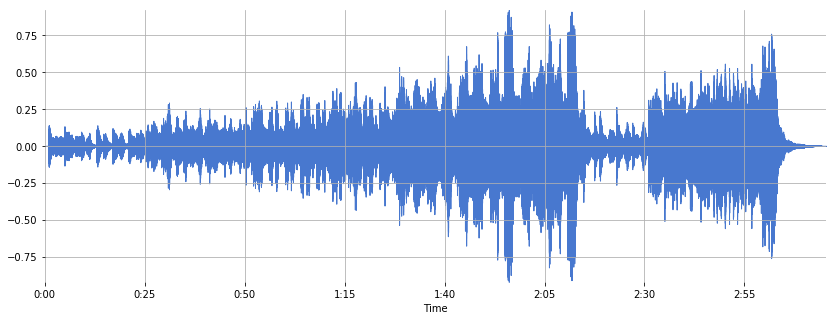

In [3]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr)

In [4]:
onset_frames = librosa.onset.onset_detect(x, sr=sr, wait=1, pre_avg=1, post_avg=1, pre_max=1, post_max=1)
print(onset_frames) # frame numbers of estimated onsets

[  43  147  169  200  211  286  317  328  339  369  380  390  411  453
  464  475  553  563  585  628  639  650  728  738  799  900  911  954
  985 1028 1049 1083 1104 1147 1158 1200 1254 1275 1315 1326 1336 1410
 1420 1431 1493 1504 1515 1556 1587 1598 1608 1618 1660 1670 1731 1751
 1771 1812 1834 1895 1905 1915 1926 1935 1976 1997 2079 2099 2141 2162
 2224 2234 2243 2264 2285 2306 2327 2409 2442 2483 2494 2505 2579 2589
 2610 2652 2674 2747 2758 2779 2820 2831 2842 2926 2947 2989 3010 3041
 3052 3062 3074 3088 3099 3120 3161 3172 3183 3214 3235 3256 3267 3287
 3319 3330 3351 3382 3426 3436 3457 3499 3510 3521 3605 3626 3635 3657
 3678 3689 3699 3741 3765 3786 3806 3817 3849 3859 3880 3891 3912 3943
 3964 3974 3995 4028 4038 4059 4080 4090 4102 4122 4144 4154 4175 4186
 4197 4217 4271 4281 4302 4312 4333 4343 4355 4366 4407 4418 4429 4440
 4462 4473 4484 4494 4505 4515 4526 4537 4610 4621 4631 4642 4652 4663
 4673 4683 4694 4705 4716 4757 4778 4800 4810 4820 4831 4841 4852 4862
 4873 

In [5]:
onset_times = librosa.frames_to_time(onset_frames)
print(onset_times)

[  0.99845805   3.41333333   3.92417234   4.64399093   4.89941043
   6.64090703   7.36072562   7.61614512   7.87156463   8.56816327
   8.82358277   9.05578231   9.54340136  10.51863946  10.77405896
  11.02947846  12.84063492  13.07283447  13.58367347  14.58213152
  14.83755102  15.09297052  16.90412698  17.13632653  18.55274376
  20.89795918  21.15337868  22.15183673  22.87165533  23.87011338
  24.35773243  25.14721088  25.63482993  26.63328798  26.88870748
  27.86394558  29.11782313  29.60544218  30.53424036  30.78965986
  31.02185941  32.74013605  32.9723356   33.2277551   34.66739229
  34.92281179  35.17823129  36.13024943  36.85006803  37.10548753
  37.33768707  37.56988662  38.54512472  38.77732426  40.1937415
  40.65814059  41.12253968  42.07455782  42.58539683  44.00181406
  44.23401361  44.46621315  44.72163265  44.93061224  45.88263039
  46.37024943  48.27428571  48.73868481  49.7139229   50.20154195
  51.64117914  51.87337868  52.08235828  52.56997732  53.05759637
  53.545215

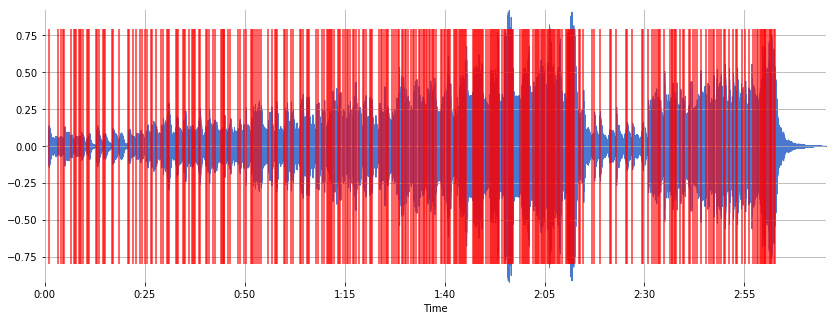

In [6]:
plt.figure(figsize=(14, 5))
librosa.display.waveplot(x, sr=sr)
plt.vlines(onset_times, -0.8, 0.79, color='r', alpha=0.8) 

In [7]:
clicks = librosa.clicks(frames=onset_frames, sr=sr, length=len(x))
ipd.Audio( x+clicks, rate=sr)

In [8]:
cowbell, _ = librosa.load('audio/cowbell.wav')
clicks = librosa.clicks(frames=onset_frames, sr=sr, length=len(x), click=cowbell)
ipd.Audio( x+clicks, rate=sr)